# Drift detection for text data using evidently:
This notebook demonstrates drift detection for text data using evidently using IMDB reviews and eco-dot reviews. Here, each record is represented as a sentence vector by using glove6B 50d vector (by averaging) for both IMDB and eco-dot reviews datasets. Incase a vector representation is not present for a particular word, we use 50d zero vector.

**There are 3 different scenarios of drift between datasets demonstrated in this notebook as indicated below:**

1) Drift between **train and test splits of the IMDB movie reviews**.

2) Drift between **IMDB train and only positive reviews from IMDB test**

3) Drift between **IMDB reviews and eco-dot reviews(unseen dataset)**

## Imports

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [2]:
try:
    import evidently
except:
    !npm install -g yarn
    !pip install git+https://github.com/evidentlyai/evidently.git

In [3]:
from evidently.options.data_drift import DataDriftOptions
from evidently.test_suite import TestSuite
from evidently.tests import *

from evidently.dashboard import Dashboard
from evidently.dashboard.tabs import DataDriftTab

/usr/local/lib/python3.7/dist-packages/evidently/analyzers/__init__.py:3: UserWarning: analyzers are deprecated, use metrics instead
  warnings.warn("analyzers are deprecated, use metrics instead")
/usr/local/lib/python3.7/dist-packages/evidently/dashboard/__init__.py:8: UserWarning: dashboards are deprecated, use metrics instead
  warnings.warn("dashboards are deprecated, use metrics instead")


## Load cleaned Imdb movies review dataset (5000 rows) and amazon ecodot review dataset(2500 rows)

In [4]:
# IMDB reviews

imdb_5k_data = pd.read_csv("https://raw.githubusercontent.com/SangamSwadiK/test_dataset/main/cleaned_imdb_data_5000_rows.csv")
imdb_5k_data.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production The filming tech...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically theres a family where a little boy J...,negative
4,Petter Matteis Love in the Time of Money is a ...,positive


In [5]:
# amazon product review data of Gen3EcoDot 

eco_dot_data = pd.read_csv("https://raw.githubusercontent.com/SangamSwadiK/test_dataset/main/eco_data.csv", squeeze=True)
eco_dot_data.head()

0                              able play youtube alexa
1    able recognize indian accent really well drop ...
2    absolute smart device amazon connect external ...
3    absolutely amaze new member family control hom...
4    absolutely amaze previously sceptical invest m...
Name: review, dtype: object

## Load glove vectors

In [6]:
## Run this to experiment with the dataset with various ways of embedding (average over records / sum of records etc ...)
!wget http://nlp.stanford.edu/data/glove.6B.zip -P /content/test/
!unzip  /content/test/glove.6B.zip -d /content/test/

--2022-11-16 09:53:33--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2022-11-16 09:53:33--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2022-11-16 09:53:33--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘/content/test/glove

In [7]:
# Load glove vector from vector file
def load_glove_model(File):
  """ Loads the keyed vectors from a given text file
  Args:
    File: text file which contains the vectors
  Returns:
    Dictionary: map containing the key:vector pair
  """
  glove_model = {}
  with open(File,'r') as f:
      for line in f:
          split_line = line.split()
          word = split_line[0]
          embedding = np.array(split_line[1:], dtype=np.float64)
          glove_model[word] = embedding
      return glove_model

In [8]:
# We load 50 dimension vector here
glove_vec = load_glove_model("/content/test/glove.6B.50d.txt")

## Train test split the imdb dataset for input data drift comparison

In [9]:
## Perform train test split on imdb data
train_df, test_df, y_train, y_test = train_test_split(imdb_5k_data.review, imdb_5k_data.sentiment, test_size=0.50, random_state=42)

## Convert train and test records into embedding vectors

In [10]:
def get_sentence_vector(dataframe):
  """Get a sentece vector for each text/record by averaging based on counts for each text record
  Args:
    dataframe: the dataframe containing the text data
  returns:
    array: a matrix of sentence vectors for each record in the dataframe
  """
  tmp_arr = []
  for row in dataframe.values:
    tmp = np.zeros(50,)
    for word in row:
      try:
        tmp += glove_vec[word]
      except KeyError:
        tmp+= np.zeros(50,)
    tmp = tmp/len(row.split(" "))
    tmp_arr.append(tmp.tolist())

  return tmp_arr

In [11]:
train_matrix =  get_sentence_vector(train_df)

In [12]:
train_df_converted = pd.DataFrame(np.array(train_matrix), index = train_df.index)
train_df_converted.head()

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
1511,-0.381491,3.842186,3.163375,3.268990,1.716181,-0.244856,1.811342,-3.424588,-1.184743,-0.061534,...,3.774490,0.275538,-0.955406,-0.215360,-0.306830,1.241856,0.867399,-1.963373,1.666094,4.384211
1882,-0.364928,3.428283,2.872637,2.932077,1.422103,-0.258355,1.755376,-3.027312,-1.097868,-0.105749,...,3.441375,0.266090,-0.893476,-0.166002,-0.255953,1.197352,0.726796,-1.875431,1.364674,4.111564
651,-0.225922,3.184136,2.519968,2.971848,1.068490,-0.218869,1.504055,-2.913288,-0.902471,0.042850,...,3.329671,0.254596,-0.829084,-0.329340,-0.153338,0.862841,0.607194,-1.684554,1.477441,3.787845
4930,-0.261043,3.496850,2.649218,2.948960,1.283928,-0.351531,1.672046,-2.960629,-1.044285,-0.051660,...,3.454432,0.194855,-0.792499,-0.328251,-0.305474,1.009205,0.686892,-1.852934,1.563900,3.740972
3089,-0.371894,3.544178,3.041681,2.999930,1.551454,-0.209505,1.713554,-3.216542,-1.076544,-0.207425,...,3.562595,0.262266,-0.921348,-0.065731,-0.299506,1.192069,0.847945,-1.786974,1.450985,4.078656


In [13]:
## Get the sentence vectors for test dataframe
test_matrix =  get_sentence_vector(test_df)

In [14]:
test_df_converted = pd.DataFrame(np.array(test_matrix), index = test_df.index)
test_df_converted.head()

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
1501,-0.301892,3.456919,2.805822,2.952740,1.545965,-0.364327,1.792683,-2.878874,-1.229111,0.017821,...,3.368028,0.215296,-0.854739,-0.269794,-0.354434,1.066241,0.728645,-1.925135,1.520077,4.230904
2586,-0.427536,3.647496,2.882300,3.151114,1.414213,-0.349614,1.707540,-3.145892,-1.009917,-0.073269,...,3.537440,0.263921,-0.778365,-0.232846,-0.286558,1.135535,0.738475,-1.965921,1.504252,4.090509
2653,-0.322373,3.220931,2.661710,2.703467,1.460842,-0.336064,1.524281,-2.796387,-0.977345,-0.039393,...,3.239543,0.177134,-0.768166,-0.133148,-0.171684,1.097073,0.691741,-1.682584,1.445865,3.591712
1055,-0.234422,3.295430,2.769252,2.916453,1.346506,-0.195492,1.554906,-2.946577,-1.006702,-0.067785,...,3.485205,0.271937,-0.748010,-0.253616,-0.213026,1.186579,0.736563,-1.736270,1.447214,3.903953
705,-0.298585,3.467689,2.833680,3.010032,1.445126,-0.295791,1.642785,-3.097794,-1.077196,0.023100,...,3.483806,0.254906,-0.836744,-0.211576,-0.345574,1.087492,0.762931,-1.854362,1.533544,4.021160


In [15]:
# Get sentence vector for echo dot
eco_dot_matrix = get_sentence_vector(eco_dot_data)

In [16]:
ecodot_review_df_converted = pd.DataFrame(np.array(eco_dot_matrix), index = eco_dot_data.index)
ecodot_review_df_converted.head()

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.327875,4.016490,2.791180,4.144132,1.833375,-0.312672,1.287728,-4.142395,-1.229878,1.161340,...,3.918637,-0.035790,-1.074380,-0.550616,-0.885010,0.599091,0.867318,-1.611072,3.009166,3.895240
1,-0.353587,4.744348,4.072236,4.225321,1.609850,-0.012264,2.406608,-4.641343,-1.675868,-0.039295,...,4.847699,0.667103,-1.344172,-0.314820,-0.918985,2.066251,1.230749,-2.030697,2.029354,5.928920
2,-0.436141,5.019880,3.867931,4.208932,1.866874,-0.683997,2.530752,-4.288440,-1.314428,0.170220,...,4.881951,0.363756,-0.983098,-0.482030,-0.655690,1.638361,1.098308,-2.558459,2.373431,4.871069
3,-0.520974,5.434466,3.984750,4.761608,1.522328,-0.786353,2.435981,-5.003207,-1.356486,0.155528,...,5.576414,0.392405,-0.879580,-0.363400,-0.971590,1.417375,1.163867,-2.981916,2.536001,5.487957
4,-0.445168,5.124225,3.961621,5.011146,1.692521,-0.773384,2.372935,-4.812509,-1.781645,0.553531,...,5.247725,0.419570,-1.119463,-0.591218,-0.662437,1.414253,0.961471,-2.823617,2.595306,5.771914


## Check Data Drift between train and test splits from IMDB movie review dataset

In [17]:
# Data Drift between imdb5k train and test 
options = DataDriftOptions(
  num_features_stattest ="wasserstein"
) 

data_drift = TestSuite(tests=[
   TestNumberOfDriftedColumns(options = options),
   TestShareOfDriftedColumns(options = options)
])


data_drift.run(
               reference_data = train_df_converted, 
               current_data = test_df_converted
               )
data_drift

In [18]:
#Data Drift dashboard between train and test split

imdb_data_drift_dashboard = Dashboard(tabs=[DataDriftTab(verbose_level=1)])

imdb_data_drift_dashboard.calculate(
                                     reference_data = train_df_converted, 
                                     current_data = test_df_converted
                                    )
imdb_data_drift_dashboard.show()

## Check Data Drift between IMDB Train and only positive reviews from IMDB Test

In [19]:
# Data Drift between imdb5k train and test 
options = DataDriftOptions(
  num_features_stattest ="wasserstein"
) 

data_drift = TestSuite(tests=[
   TestNumberOfDriftedColumns(options = options),
   TestShareOfDriftedColumns(options = options)
])


data_drift.run(
               reference_data = train_df_converted, 
               current_data = test_df_converted.loc[y_test[ y_test == 'positive'].index.tolist()]
               )
data_drift

In [20]:

imdb_data_drift_dashboard = Dashboard(tabs=[DataDriftTab(verbose_level=1)])

imdb_data_drift_dashboard.calculate(
                                     reference_data = train_df_converted, 
                                     current_data = test_df_converted.loc[y_test[ y_test == 'positive'].index.tolist()]
                                    )
imdb_data_drift_dashboard.show()

In [21]:
# The current batch  has only records with only positive sentiment.
# Here we can see that few embedding features have drifted out of 50.
# Therefore even though its from the same dataset, we can detect drift based on some threshold (eg: 50% of embedding features = 25 features, if they have drifted)

## Check Data drift between IMDB movie reviews and Eco-dot reviews dataset (train vs unseen dataset)

In [22]:
# Data Drift between imdb5k train Eco-dot

options = DataDriftOptions(
  num_features_stattest ="wasserstein"
) 

data_drift = TestSuite(tests=[
   TestNumberOfDriftedColumns(options = options),
   TestShareOfDriftedColumns(options = options)
])
 
data_drift.run(
               reference_data = train_df_converted, 
               current_data = ecodot_review_df_converted
               )
data_drift

In [23]:
#Data Drift dashboard between IMDB train and Eco-dot reviews

imdb_data_drift_dashboard = Dashboard(tabs=[DataDriftTab(verbose_level=1)])

imdb_data_drift_dashboard.calculate(
                                     reference_data = train_df_converted, 
                                     current_data = ecodot_review_df_converted
                                    )
imdb_data_drift_dashboard.show()

In [24]:
## It can be seen from the above that all 50 features from the embedding are of different distributions
## Hence, drift is detected

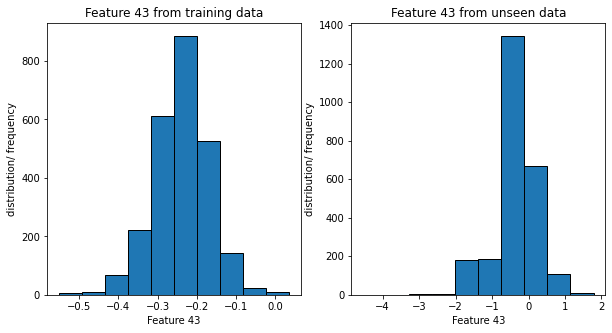

In [25]:
#Sample histogram plot for a drifted feature
f = plt.figure(figsize=(10,5))
ax1 = f.add_subplot(121)
ax2 = f.add_subplot(122)
ax1.hist(train_df_converted[43].tolist(), edgecolor = 'k')
ax2.hist(ecodot_review_df_converted[43].tolist(), edgecolor = 'k')
ax1.set_title("Feature 43 from training data")
ax2.set_title("Feature 43 from unseen data")
ax1.set_xlabel('Feature 43')
ax1.set_ylabel('distribution/ frequency')
ax2.set_xlabel('Feature 43')
ax2.set_ylabel('distribution/ frequency')
plt.show()

In [26]:
### Datasets Credits:
### IMDB and echodot reviews : https://www.kaggle.com/